<a href="https://colab.research.google.com/github/wira29/PCVK_Ganjil_2023/blob/main/28_Wiradarma_NB_week7.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [8]:
from google.colab import drive

drive.mount('/content/drive')

Mounted at /content/drive


#### Buatlah fungsi konvolusi menggunakan algoritma yang telah dijelaskan pada Bagian C, tanpa menggunakan library atau metode konvolusi dari OpenCV

In [87]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
import math


In [164]:
def convolution2d(image, kernel, stride=1, padding=0):
    height, width=image.shape
    k_height,k_width=kernel.shape
    padding_height = height + 2 * padding
    padding_width = width + 2 * padding

    padded_image = np.zeros((padding_height, padding_width))
    padded_image[padding:-padding, padding:-padding] = image

    out_height = (height - k_height + 2 * padding) // stride + 1
    out_width = (width - k_width + 2 * padding) // stride + 1

    output = np.zeros((out_height, out_width))

    for y in range(0, out_height):
        for x in range(0, out_width):

            y_start = y * stride
            y_end = y_start + kernel.shape[0]
            x_start = x * stride
            x_end = x_start + kernel.shape[1]
            pixel_value = np.sum(kernel * padded_image[y_start:y_end, x_start:x_end])

            output[y, x] = pixel_value

    return output

#### Buat Image Filter untuk Average filter, low pass filter, high pass filter, dan beberapa filter berikut:

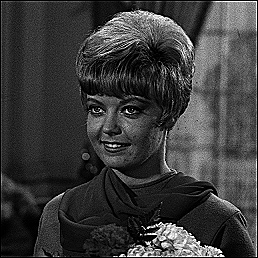

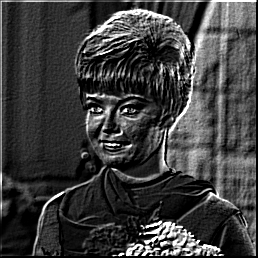

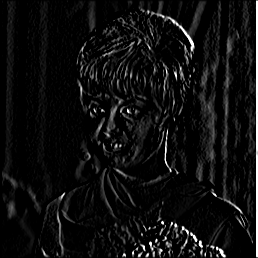

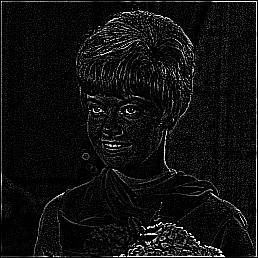

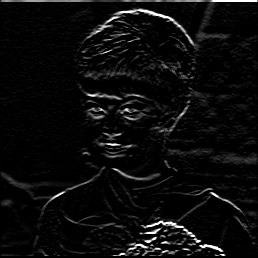

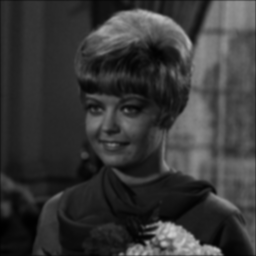

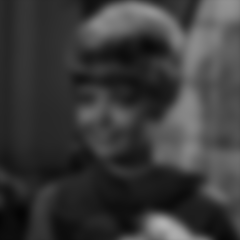

In [165]:
img = cv.imread("/content/drive/MyDrive/PCVK/images/female.tiff")
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

sharpeningKernel = np.array([[0, -1, 0],
                    [-1, 5, -1],
                    [0, -1, 0]
                  ])
sharpen_img = convolution2d(gray, sharpeningKernel, 1, 2)

embossKernel = np.array([[-2, -1, 0],
                    [-1, 1, 1],
                    [0, 1, 2]
                  ])
emboss_img = convolution2d(gray, embossKernel, 1, 2)

leftSobelKernel = np.array([[1, 0, -1],
                    [2, 0, -2],
                    [1, 0, -1]
                  ])
leftsobel_img = convolution2d(gray, leftSobelKernel, 1, 2)

cannyKernel = np.array([[-1, -1, -1],
                    [-1, 8, -1],
                    [-1, -1, -1]
                  ])
canny_img = convolution2d(gray, cannyKernel, 1, 2)

prewittKernel = np.array([[-1, -1, -1],
                    [0, 0, 0],
                    [1, 1, 1]
                  ])
prewitt_img = convolution2d(gray, prewittKernel, 1, 2)

gaussian1Kernel = np.array([[1, 4, 6, 4, 1],
                    [4, 16, 24, 16, 1],
                    [6, 24, 36, 24, 1],
                    [4, 16, 24, 16, 1],
                    [1, 4, 6, 4, 1]
                  ]) / 256
gaussian1_img = convolution2d(gray, gaussian1Kernel, 1, 2)

sigma = math.sqrt(21)
gaussian2Kernel = cv.getGaussianKernel(21, sigma)
gauss_kernel = gaussian2Kernel @ gaussian2Kernel.transpose()

gaussian2_img = convolution2d(gray, gauss_kernel, 1, 2)

cv2_imshow(sharpen_img)
cv2_imshow(emboss_img)
cv2_imshow(leftsobel_img)
cv2_imshow(canny_img)
cv2_imshow(prewitt_img)
cv2_imshow(gaussian1_img)
cv2_imshow(gaussian2_img)

#### Diketahui dataset KTP dengan kondisi citra yang berbeda. Lakukan perbaikan melalui implementasi teknik filterisasi dan detection setiap citra. Terapkan juga histogram equalization dan operasi aritmatika sebagai Teknik pendukung perbaikan citra KTP

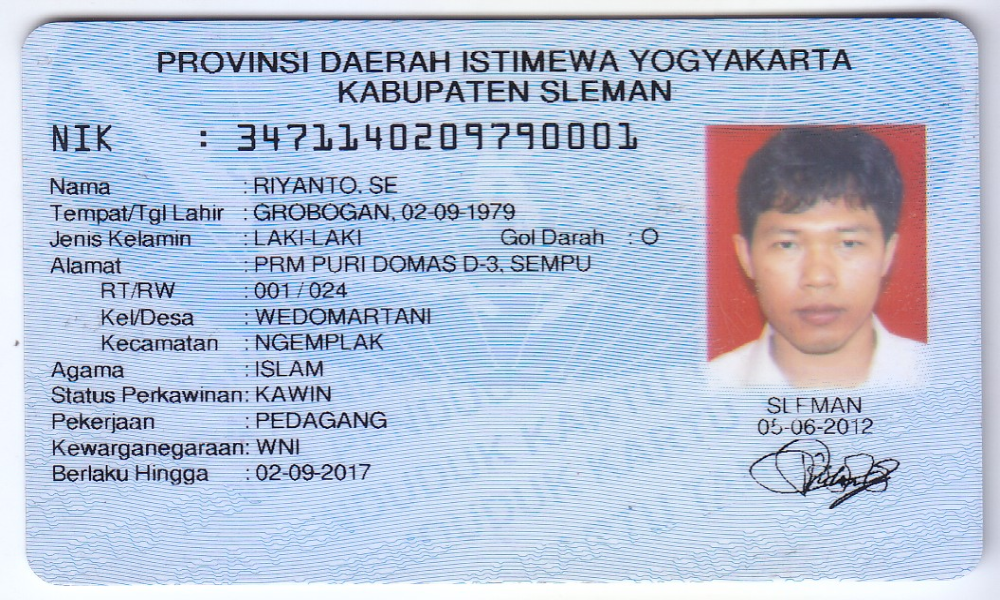

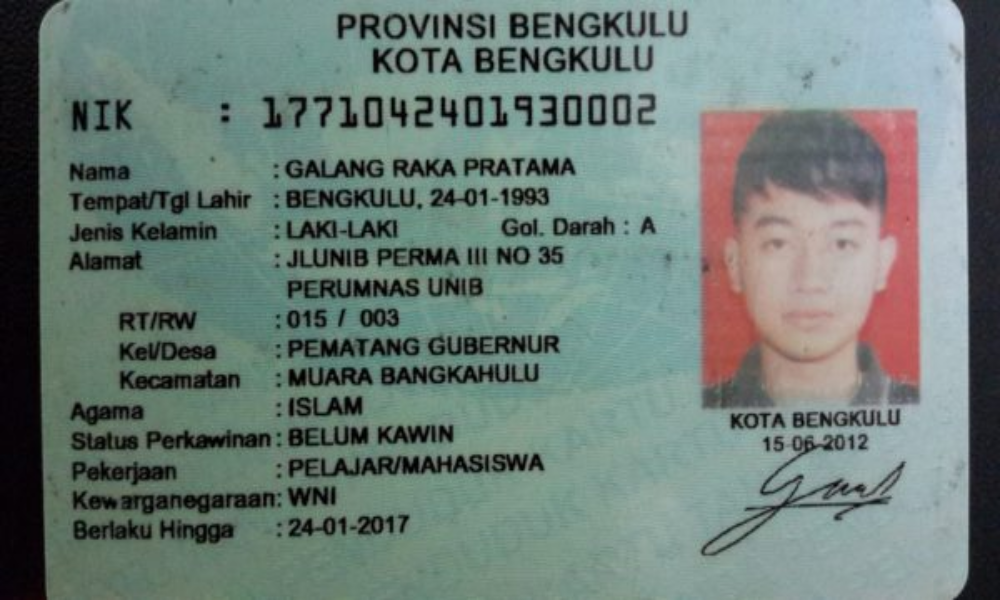

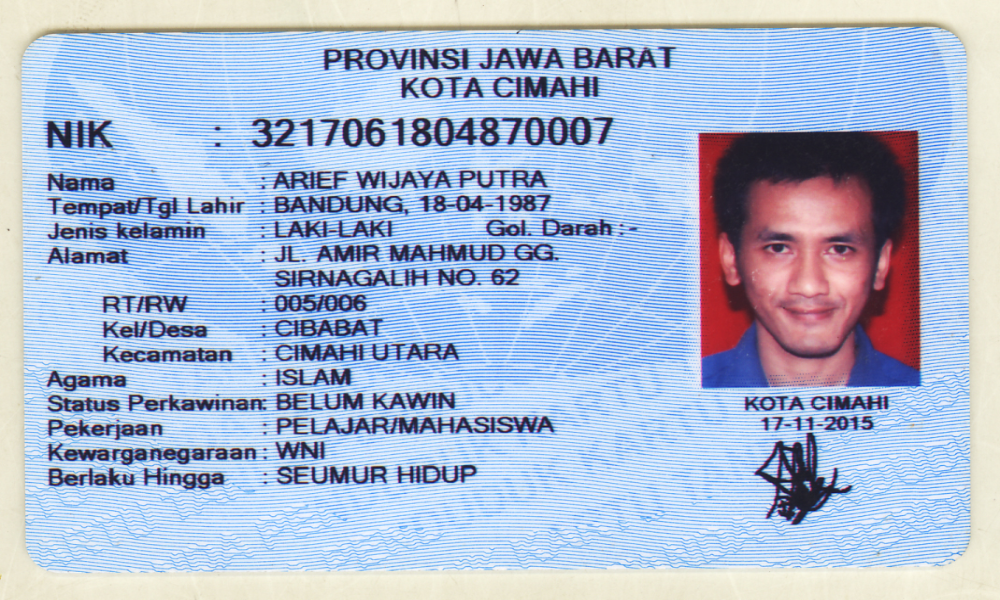

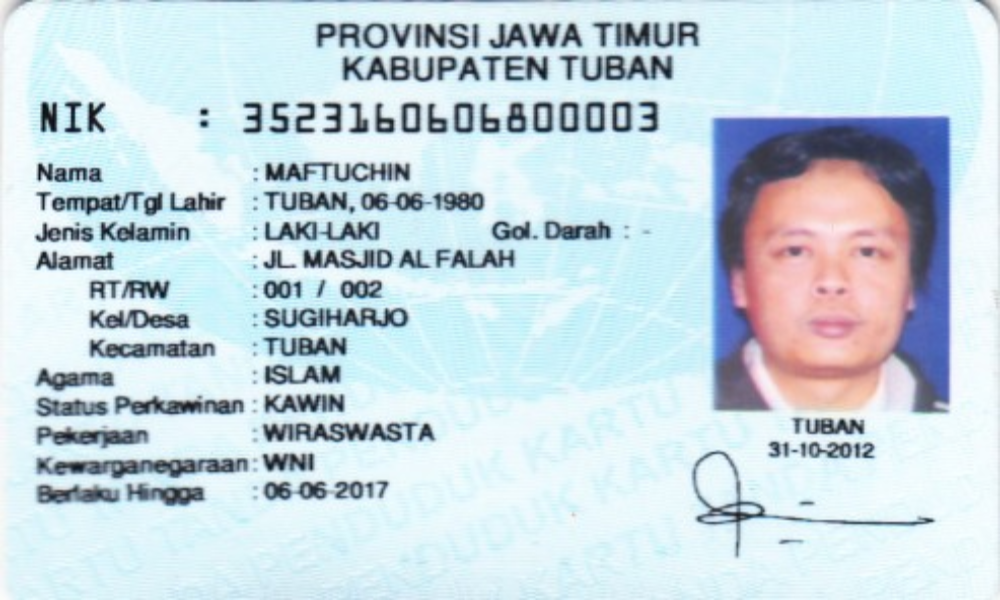

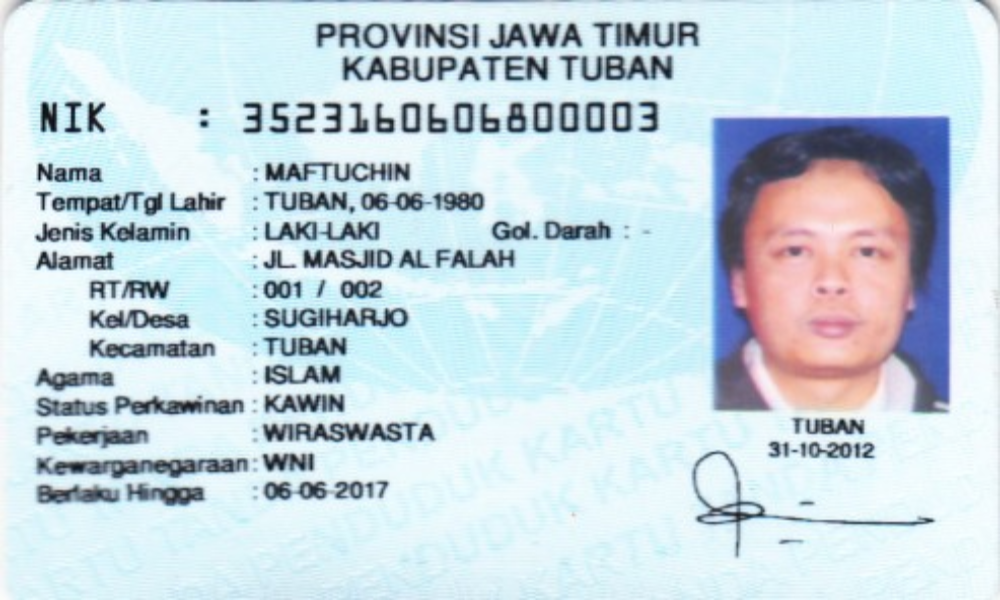

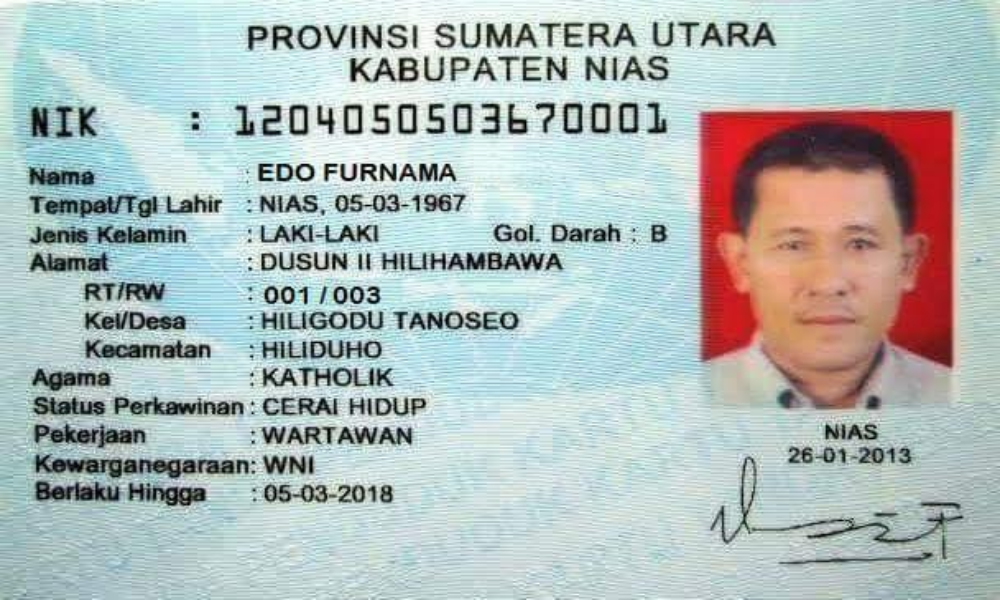

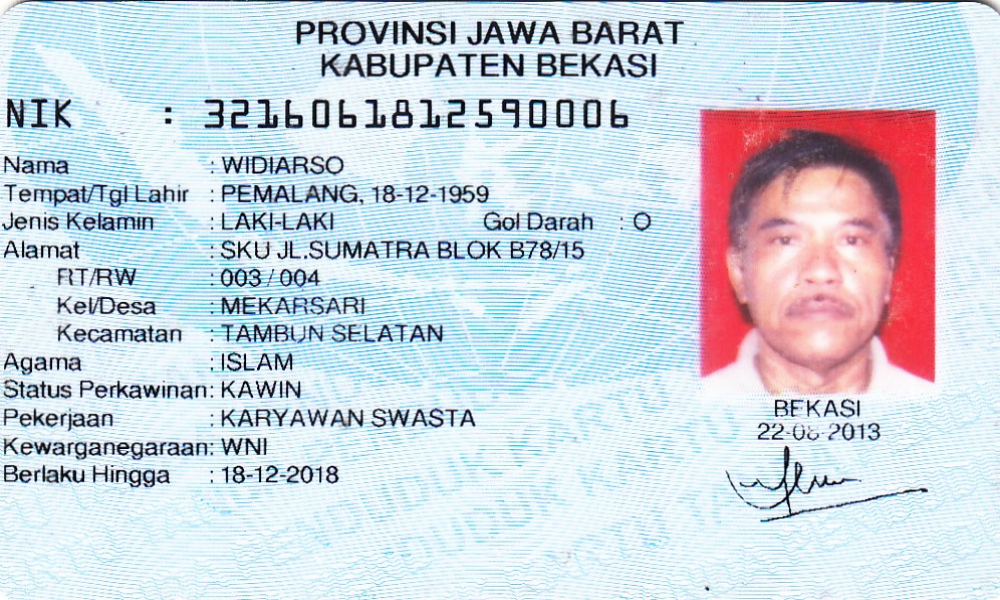

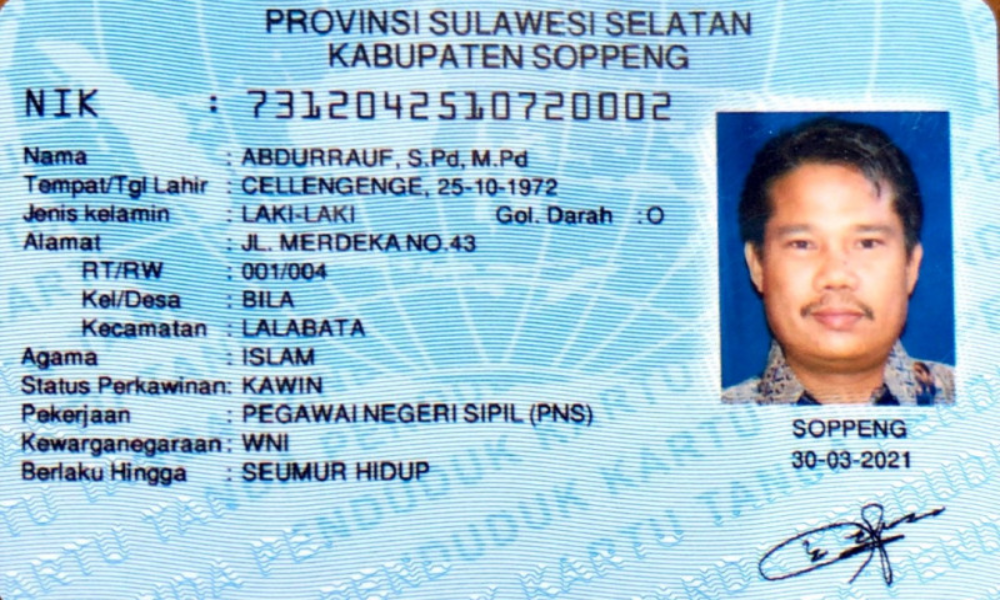

In [159]:
ktp1 = cv.imread("/content/drive/MyDrive/PCVK/images/ktp/ktp.png")
ktp2 = cv.imread("/content/drive/MyDrive/PCVK/images/ktp/ktp1.png")
ktp3 = cv.imread("/content/drive/MyDrive/PCVK/images/ktp/ktp2.png")
ktp4 = cv.imread("/content/drive/MyDrive/PCVK/images/ktp/ktp3.png")
ktp5 = cv.imread("/content/drive/MyDrive/PCVK/images/ktp/ktp4.png")
ktp6 = cv.imread("/content/drive/MyDrive/PCVK/images/ktp/ktp5.png")
ktp7 = cv.imread("/content/drive/MyDrive/PCVK/images/ktp/ktp6.png")
ktp8 = cv.imread("/content/drive/MyDrive/PCVK/images/ktp/KTP7.jpeg")

ktp1 = cv.resize(ktp1, (1000, 600))
ktp2 = cv.resize(ktp2, (1000, 600))
ktp3 = cv.resize(ktp3, (1000, 600))
ktp4 = cv.resize(ktp4, (1000, 600))
ktp5 = cv.resize(ktp5, (1000, 600))
ktp6 = cv.resize(ktp6, (1000, 600))
ktp7 = cv.resize(ktp7, (1000, 600))
ktp8 = cv.resize(ktp8, (1000, 600))

cv2_imshow(ktp1)
cv2_imshow(ktp2)
cv2_imshow(ktp3)
cv2_imshow(ktp4)
cv2_imshow(ktp5)
cv2_imshow(ktp6)
cv2_imshow(ktp7)
cv2_imshow(ktp8)

In [120]:
def brightness(image, n):
  return cv.convertScaleAbs(image, alpha=n, beta=0)

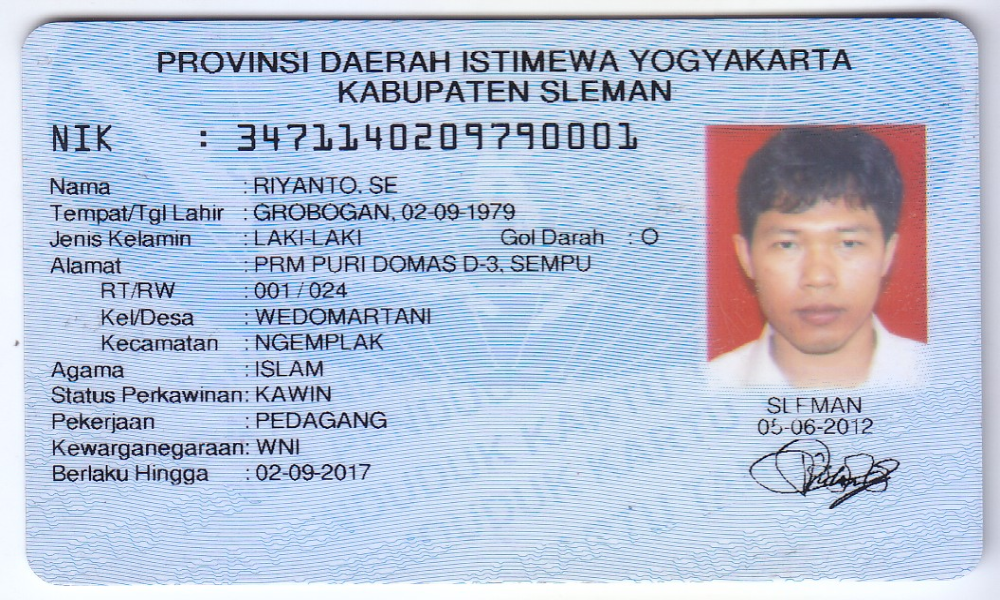

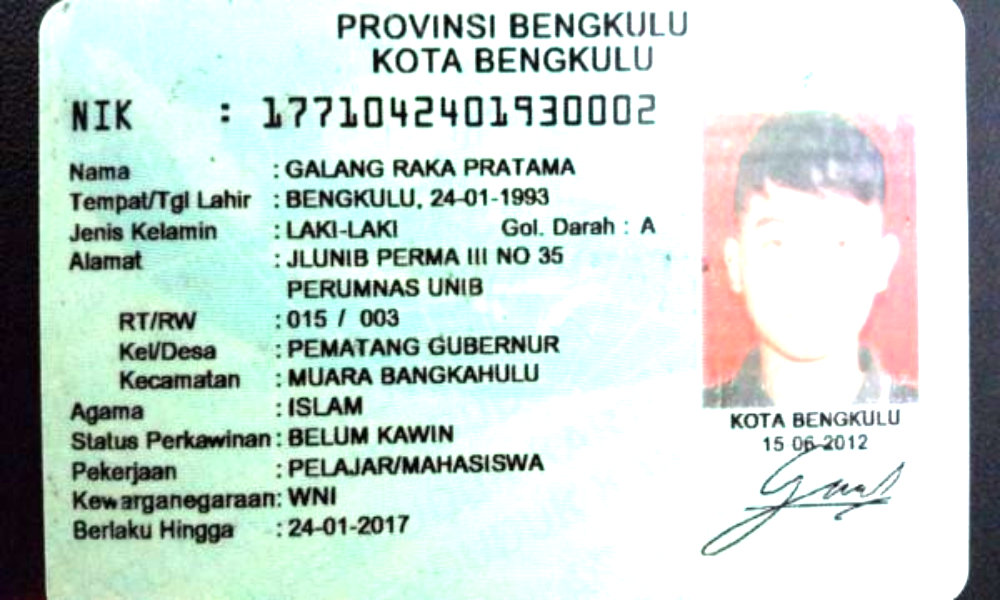

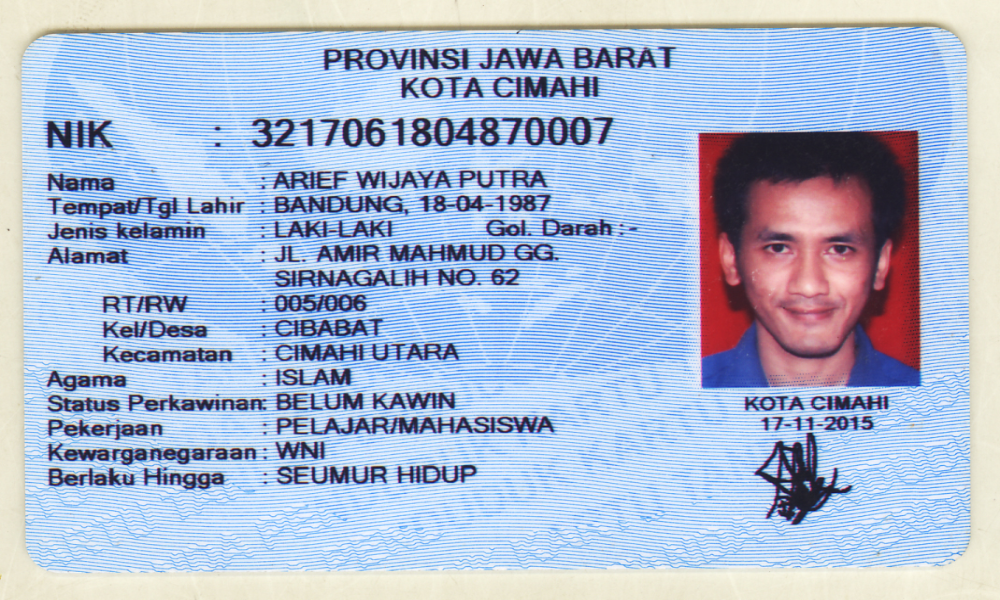

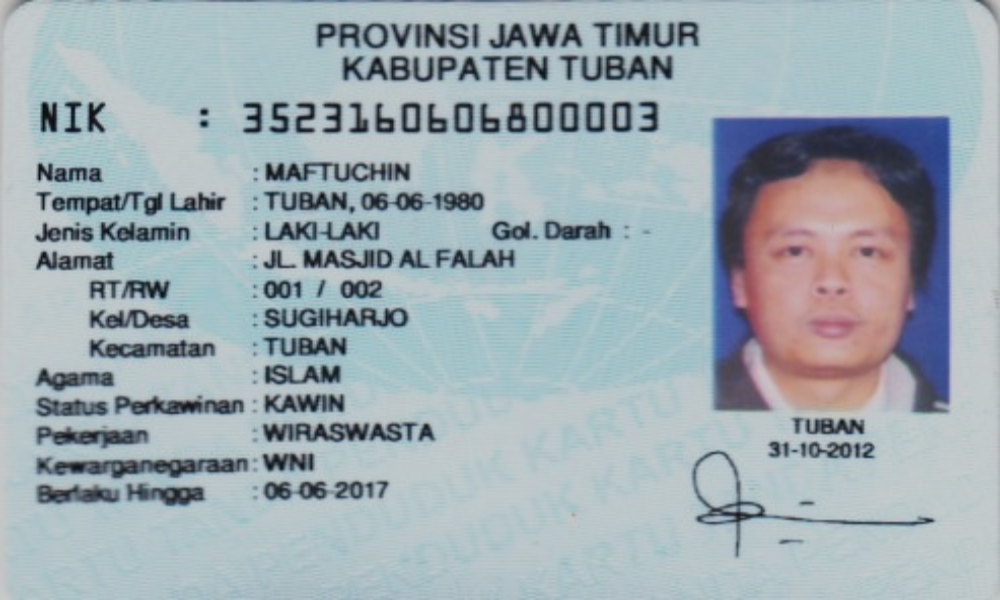

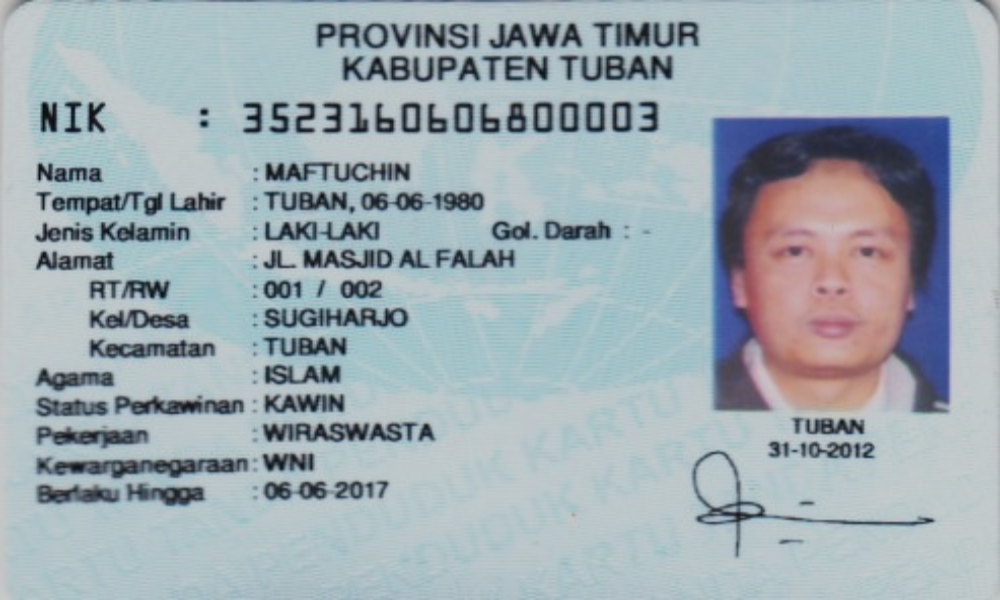

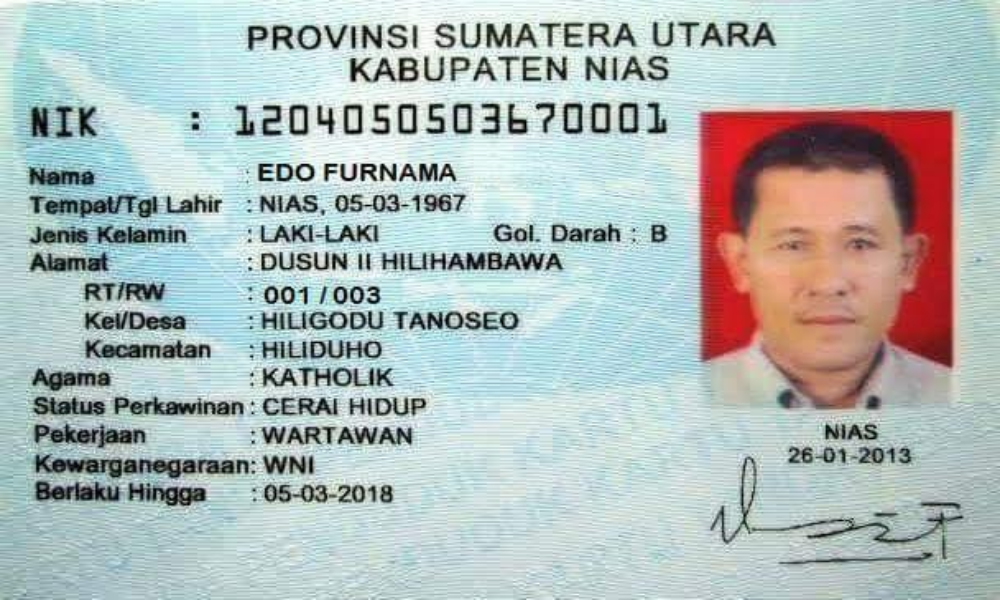

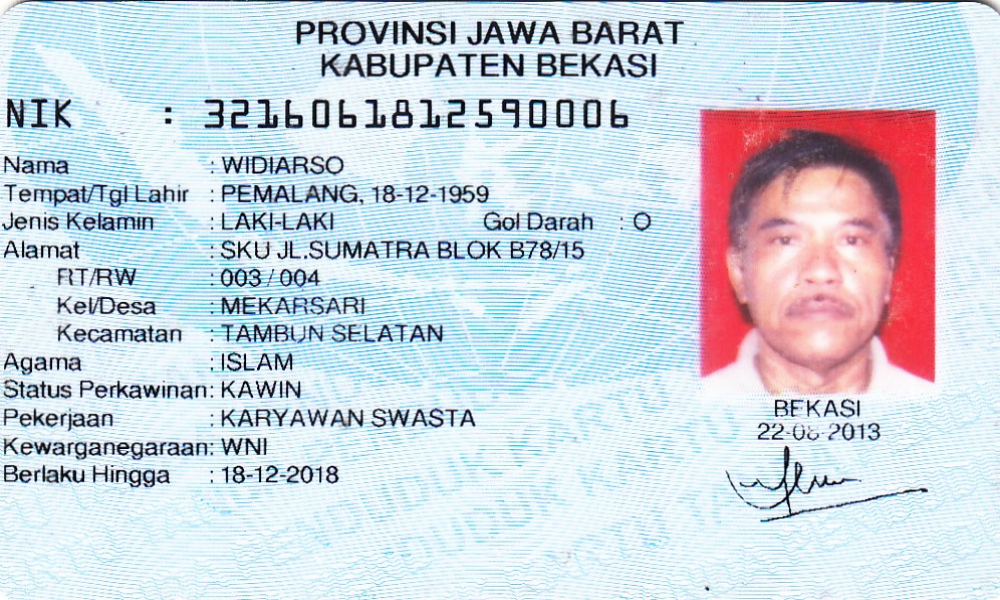

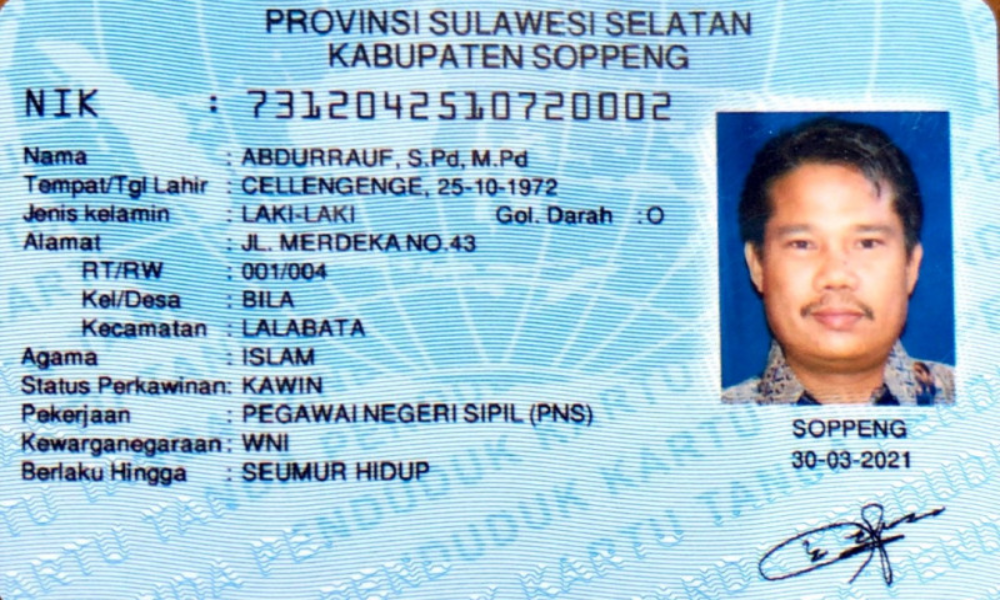

In [153]:
ktp2 = brightness(ktp2, 2)
ktp4 = brightness(ktp4, 0.8)
ktp5 = brightness(ktp5, 0.8)

cv2_imshow(ktp1)
cv2_imshow(ktp2)
cv2_imshow(ktp3)
cv2_imshow(ktp4)
cv2_imshow(ktp5)
cv2_imshow(ktp6)
cv2_imshow(ktp7)
cv2_imshow(ktp8)

In [146]:
def histog(img):
  height, width, depth = np.shape(img)
  ax = np.zeros((3,256))
  for y in range(0,height) :
    for x in range(0,width) :
      ax[0][img[y][x][0]] += 1
      ax[1][img[y][x][1]] += 1
      ax[2][img[y][x][2]] += 1
  return ax

def equalize(img):
  histo_asli = histog(img)

  blue = [0]*256
  green = [0]*256
  red = [0]*256

  #convert to Numpy array
  img_array = np.asarray(img)

  #Step 1: Normalized cumulative histogram
  #flatten image array and calculate histogram via binning
  histogram_array = np.bincount(img_array.flatten(), minlength=256)

  #normalize
  num_pixels = np. sum(histogram_array)
  histogram_array = histogram_array/num_pixels

  #normalized cumulative histogram
  chistogram_array = np.cumsum(histogram_array)

  #Step 2: Pixel mapping lookup table
  transform_map = np.floor(255 * chistogram_array). astype (np.uint8)

  #Step 3: Transformation
  # flatten image array into 10 list
  img_list = list(img_array.flatten())

  # transform pixel values to equalize
  eq_img_list = [transform_map[p] for p in img_list]

  # reshape and write back into img_array
  eq_img_array = np.reshape(np.asarray(eq_img_list), img_array.shape)
  img2 = eq_img_array

  equal_histo = histog(img2)

  final_frame = cv.hconcat((img, img2)) #concatenate image
  cv2_imshow(final_frame)

  names = np.arange (256)
  isgrayimg = np.array_equal(blue, green, red)

  fig, axs = plt.subplots(2, 3, figsize=[20,5], sharex=True, sharey=True)
  fig.suptitle('Histogram RGB plot')
  fig.text(0.09, 0.5, 'Jumlah Kemunculan', va='center', rotation='vertical')
  fig.text(0.5, 0.04, 'Intensitas Warna', ha='center')
  axs[0,0].bar(names, histo_asli[2], color='red')
  axs[0,1].bar(names, histo_asli[1], color='green')
  axs[0,2].bar(names, histo_asli[0], color='blue')
  axs[1,0].bar(names, equal_histo[2], color='red')
  axs[1,1].bar(names, equal_histo[1], color='green')
  axs[1,2].bar(names, equal_histo[0], color='blue')


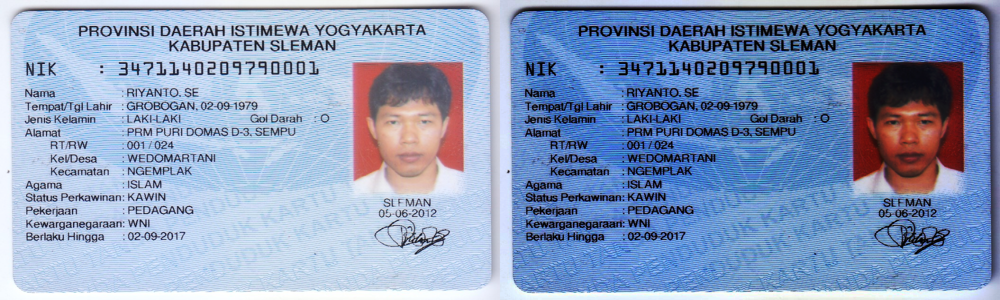

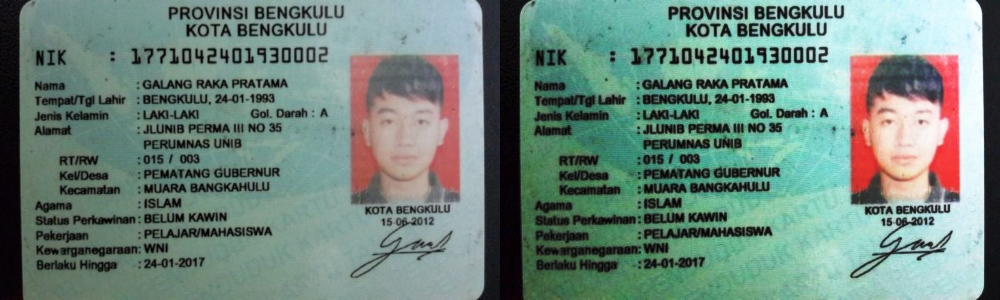

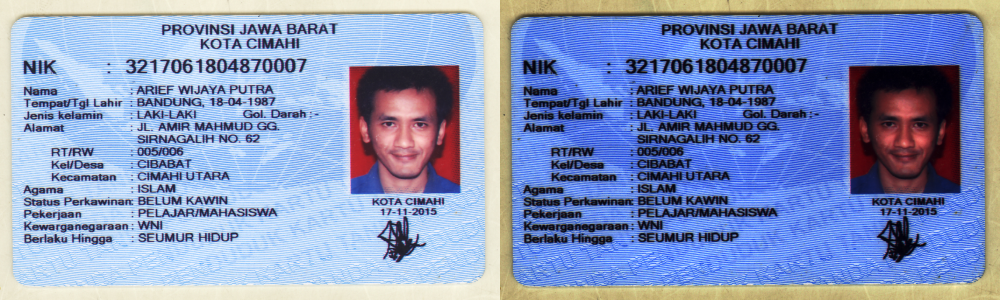

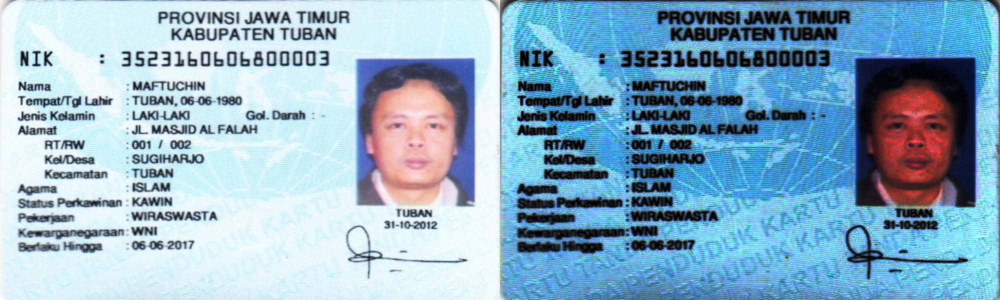

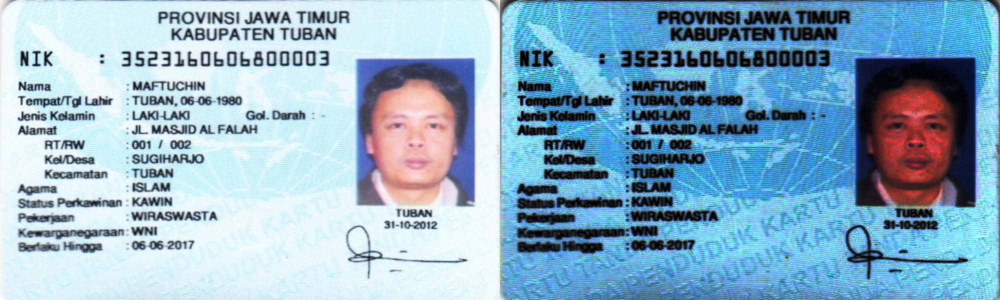

...

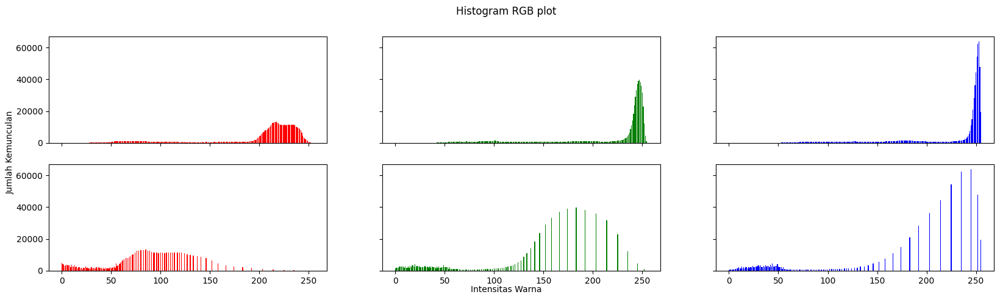

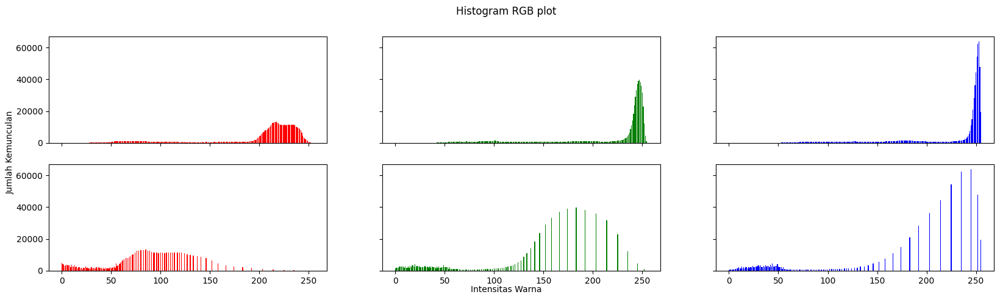

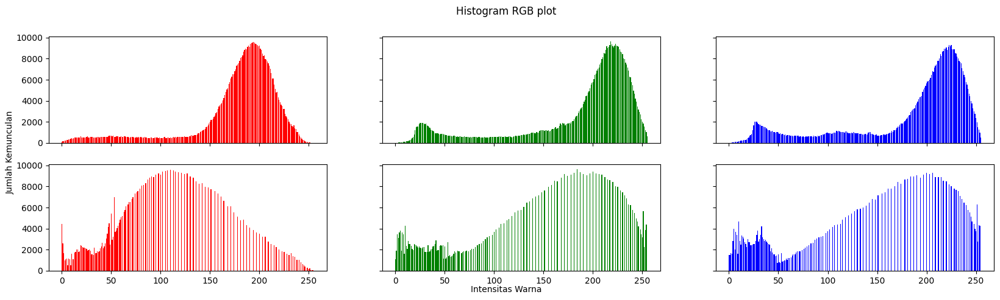

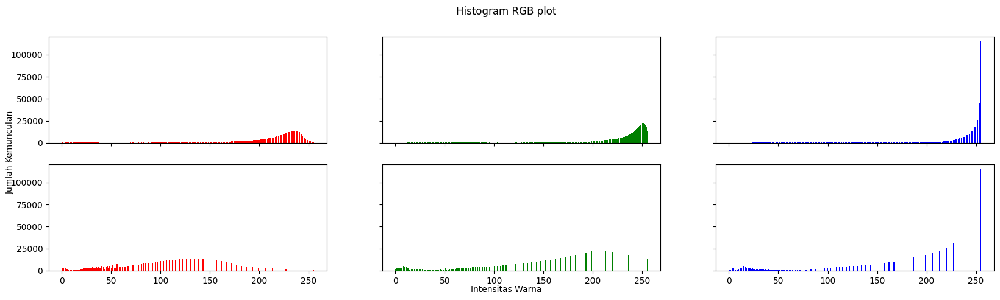

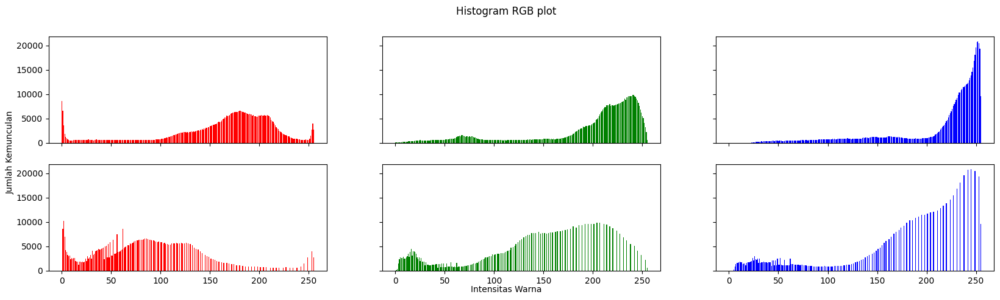

In [167]:
equalize(ktp1)
equalize(ktp2)
equalize(ktp3)
equalize(ktp4)
equalize(ktp5)
equalize(ktp6)
equalize(ktp7)
equalize(ktp8)